# Instructions for using this notebook
To use this notebook, follow the instructions below to first install the required libraries. Once all the libraries are place, you can run the notebook by pressing the play button to run just one cell. To run the whole notebook use the double play button and click okay in the dialog that appears.
## Required libraries
1\. PYROSM <br>
2\. PANDAS <br>
3\. GEOPANDAS <br>
4\. GEOJSON <br>
5\. GEOJSONIO <br>
6\. JSON
### Install the libraries
if any library is missing, please use the intructions below to install them. If the instructions are note here then do a goole search with the reported error log for it. That should help.
#### Instructions for installing PYROSM
To perform the installation, please follow the instructions in the link:
__https://pyrosm.readthedocs.io/en/latest/installation.html__
#### Instructions for PANDAS
if Pandas is not already installed, follow the instructions in the link (use pip as instructed in the page): __https://pandas.pydata.org/docs/getting_started/install.html__ 
#### Instructions for GEOPANDAS
Usually the installation of PYROSM will install GEOPANDAS. if GEOPANDAS is not already installed, follow the instructions in the link (use pip as instructed in the page): __https://geopandas.org/en/stable/getting_started/install.html__
#### Instructions for GEOJSON
if GEOJSON is not already installed, follow the instructions in the link (use pip as instructed in the page): __https://pypi.org/project/geojson/__
#### Instructions for GEOJSONIO
This libray is used to display data in geojson format in map through the link: __https://geojson.io/#map=2/20.0/0.0__ <br>
To install GEOJSONIO, follow the instruction in the link: __https://pypi.org/project/geojsonio/__
#### Instructions for JSON
if it is not already in your Python environment then use: pip install json 

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
# import the needed libraries. The import is global
from pyrosm import OSM
from pyrosm import get_data

import geopandas
import pandas as pd

import geojson

import geojsonio

import pika

from geojson import Feature
from geojson import FeatureCollection

import folium

#from turfpy.measurement import rhumb_bearing

import sys
import os
import datetime
from datetime import datetime
from datetime import timedelta


In [4]:
# path for user defined modules
modules_path = os.path.abspath(os.path.join('../python-modules'))
sys.path.insert(0, modules_path)

In [5]:
# import user defined python modules
import shapely_json_lines as sjl
import constant_data as cData
import GeometryData as gdata
import FeatureCollectionData as fcData
import neighbour_search as nb_s
import RoadNetworkManager as nManager
import CummulativeDistanceAndTime
import EnrichedCoordinates
import connectedsegments
import neighboursearch
import filterfunctions
import barefootoutput
from testdataselector import TestDataSelector
import LineStringData
import similarity_analysis
import dekoderoutput
import featurecollectionsdata

In [6]:
# paths
data_path = "../../../data/"

In [7]:
# set the file containing the map data.
osm = OSM(data_path + "gothenburg.osm.pbf")

In [8]:
# Read road networks from the map
nodes, edges = osm.get_network(network_type="driving", nodes=True)

In [9]:
#nodes.explore()

In [10]:
#edges.explore()

In [11]:
filterfxns = filterfunctions.filterfunctions()

In [12]:
filtered_network_graph = filterfxns.filterRoadNetwork(edges)

In [13]:
filtered_network_graph.explore()

In [14]:
filtered_network_graph.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 13945 entries, 42 to 370533
Data columns (total 38 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   access         141 non-null    object  
 1   area           0 non-null      object  
 2   bicycle        195 non-null    object  
 3   bridge         676 non-null    object  
 4   cycleway       12 non-null     object  
 5   foot           153 non-null    object  
 6   highway        13945 non-null  object  
 7   int_ref        2557 non-null   object  
 8   junction       672 non-null    object  
 9   lanes          10377 non-null  object  
 10  lit            2712 non-null   object  
 11  maxspeed       12547 non-null  object  
 12  motorcar       0 non-null      object  
 13  motorroad      25 non-null     object  
 14  motor_vehicle  2 non-null      object  
 15  name           6436 non-null   object  
 16  oneway         11822 non-null  object  
 17  overtaking     0 non-

In [15]:
filtered_nodes = filterfxns.filternodes(nodes, filtered_network_graph)

(57.55, 57.875)

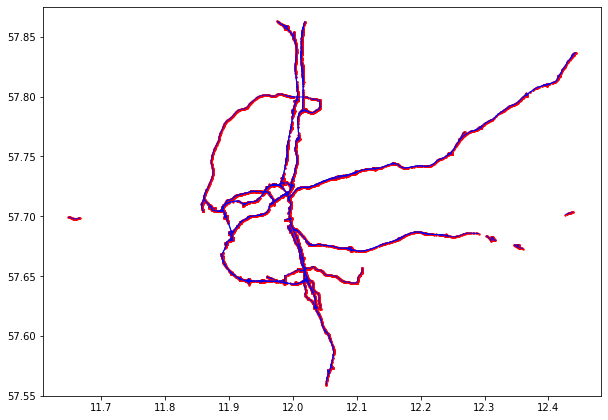

In [16]:
ax = filtered_network_graph.plot(figsize=(10,10), color="blue", lw=1.0)
ax = filtered_nodes.plot(ax=ax, color="red", markersize=2)
ax.set_ylim([57.55, 57.875])

<AxesSubplot:>

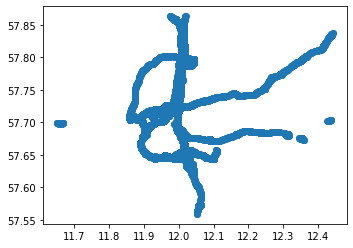

In [17]:
filtered_nodes.plot()

In [18]:
segments = [4040302, 284402021, 226048677]#, 13865743,13865744, 284402510]
gdf_test_segments = filterfxns.filterRoadNetworkWithId(filtered_network_graph, segments)

In [19]:
filtered_nodes_test = filterfxns.filternodes(nodes, gdf_test_segments)

(57.855, 57.865)

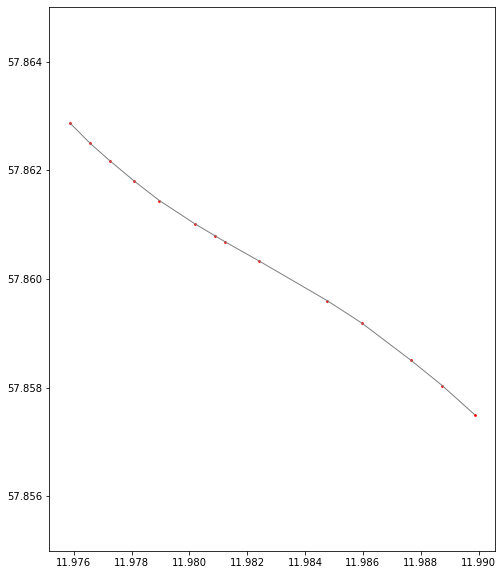

In [20]:
ax1 = gdf_test_segments.plot(figsize=(10,10), color="grey", lw=1.0)
ax1 = filtered_nodes_test.plot(ax=ax1, color="red", markersize=3)
ax1.set_ylim([57.855, 57.865])

In [21]:
filtered_network_graph = filterfxns.filterRoadNetworkWithNegationAndCopy(filtered_network_graph)

In [22]:
filtered_nodes_test = filterfxns.filternodes(nodes, filtered_network_graph)

(57.55, 57.875)

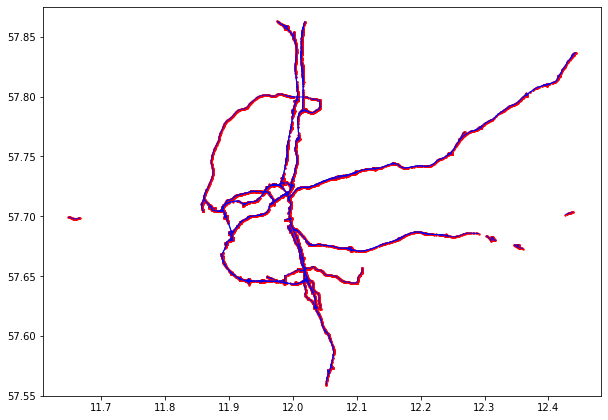

In [23]:
ax3 = filtered_network_graph.plot(figsize=(10,10), color="blue", lw=1.0)
ax3 = filtered_nodes_test.plot(ax=ax3, color="red", markersize=2)
ax3.set_ylim([57.55, 57.875])

In [24]:
filtered_network_graph = CummulativeDistanceAndTime.fixNAForMaxSpeed(filtered_network_graph)
filtered_network_graph["maxspeed"].unique()

<IntegerArray>
[100, 70, 60, 80, <NA>, 50, 90, 40, 30, 110]
Length: 10, dtype: Int64

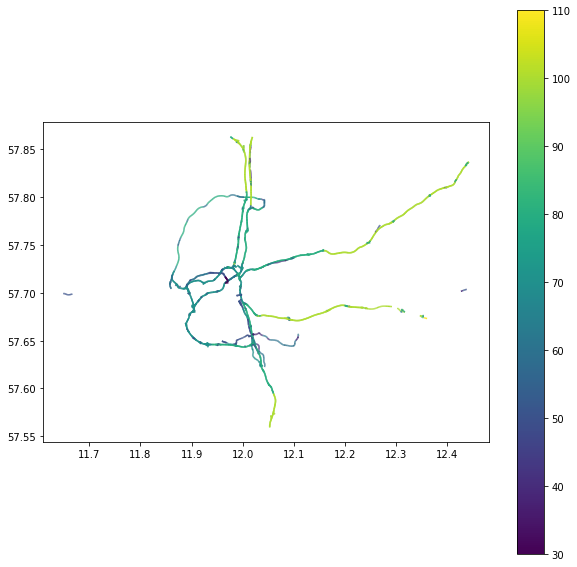

In [25]:
filtered_network_graph = CummulativeDistanceAndTime.replaceNAInMaxSpeed(filtered_network_graph)
ax = filtered_network_graph.plot(column="maxspeed", figsize=(10,10), legend=True)

In [26]:
drive_net = osm.get_network(network_type="driving")

In [27]:
gdf_E6_graph = filterfxns.filterRoadNetworkWithRef(filtered_network_graph, ['E 6'])

In [28]:
refslist = ['E 6', 'E 6.20', 'E 20', 'E 6;E 20', 'E 45']
nameslist = ['Oscarsleden']

In [29]:
large_graph = filterfxns.filterRoadNetworkWithRefAndNames(edges, nameslist, refslist)

In [30]:
large_graph.explore()

In [31]:
#filterfuncs = filterfunctions.filterfunctions()
#filtered_network = drive_net[(drive_net['name'].isin(nameslist)) | (drive_net['ref'].isin(ref_list))] #filterfuncs.filterRoadNetwork(drive_net)

In [32]:
#targetNetwork = drive_net[(drive_net['name'].isin(nameslist)) | (drive_net['ref'].isin(ref_list))]

In [33]:
#roadNetworkManager_validator = nManager.RoadNetworkManager()

In [34]:
#roadNetworkManager_validator.createlinesFromRoadGraphNetwork(targetNetwork, filtered_network, large_graph)

In [35]:
#gdf_validate.explore()

# Initial analysis of Data for OpenLR and Barefoot

In [36]:
#lineStringData = LineStringData.LineStringData()

In [37]:
#input_lines = lineStringData.get_linestring_from_ids(large_graph, test_segments)

In [38]:
#decoder_json_data = {"lineLocation":{"lines":[{"id":1251044743,"wkt":"LINESTRING (11.97563 57.86302, 11.9762 57.86271, 11.977 57.8623, 11.97784 57.86192)"},{"id":1251044742,"wkt":"LINESTRING (11.97784 57.86192, 11.97871 57.86156, 11.97935 57.86132)"},{"id":1296350969,"wkt":"LINESTRING (11.97935 57.86132, 11.97963 57.86122, 11.98058 57.86091, 11.98154 57.86061, 11.98275 57.86025, 11.98339 57.86006, 11.98345 57.86004, 11.98411 57.85983)"},{"id":1296350968,"wkt":"LINESTRING (11.98411 57.85983, 11.98437 57.85974, 11.98468 57.85964)"},{"id":1185976985,"wkt":"LINESTRING (11.98468 57.85964, 11.98498 57.85954)"},{"id":1185976984,"wkt":"LINESTRING (11.98498 57.85954, 11.98523 57.85946)"},{"id":1251331681,"wkt":"LINESTRING (11.98523 57.85946, 11.98542 57.8594, 11.98572 57.85929)"},{"id":1251331680,"wkt":"LINESTRING (11.98572 57.85929, 11.98597 57.8592, 11.98659 57.85897, 11.98697 57.85882)"},{"id":711523413,"wkt":"LINESTRING (11.98697 57.85882, 11.98759 57.85857, 11.98794 57.85842, 11.9883 57.85825, 11.98869 57.85807, 11.98909 57.85788, 11.98946 57.8577, 11.98981 57.85753)"},{"id":1165044750,"wkt":"LINESTRING (11.98981 57.85753, 11.9901 57.85739, 11.99024 57.85731, 11.99046 57.85721)"},{"id":1165044749,"wkt":"LINESTRING (11.99046 57.85721, 11.99091 57.85698, 11.99163 57.85659)"},{"id":1155434906,"wkt":"LINESTRING (11.99163 57.85659, 11.9923 57.85622)"},{"id":1165052207,"wkt":"LINESTRING (11.9923 57.85622, 11.99308 57.85577)"},{"id":1165052206,"wkt":"LINESTRING (11.99308 57.85577, 11.9934 57.85558)"},{"id":1185978411,"wkt":"LINESTRING (11.9934 57.85558, 11.994 57.85521)"},{"id":1269276268,"wkt":"LINESTRING (11.994 57.85521, 11.99447 57.85492)"},{"id":1269276267,"wkt":"LINESTRING (11.99447 57.85492, 11.99481 57.8547)"},{"id":1269276270,"wkt":"LINESTRING (11.99481 57.8547, 11.99565 57.85415, 11.99609 57.85386, 11.99657 57.85353, 11.99718 57.8531, 11.99726 57.85304)"},{"id":1269276269,"wkt":"LINESTRING (11.99726 57.85304, 11.99791 57.85257, 11.99861 57.85201, 11.9993 57.85148, 11.99966 57.85117, 12.00026 57.85059, 12.00068 57.85016, 12.00085 57.84998)"},{"id":31537858,"wkt":"LINESTRING (12.00085 57.84998, 12.00115 57.84966, 12.00165 57.84905, 12.00212 57.84842, 12.00248 57.8479)"},{"id":1164629410,"wkt":"LINESTRING (12.00248 57.8479, 12.0027 57.84754)"},{"id":1269276272,"wkt":"LINESTRING (12.0027 57.84754, 12.00285 57.84729)"},{"id":1269276271,"wkt":"LINESTRING (12.00285 57.84729, 12.00295 57.84711)"},{"id":1155453935,"wkt":"LINESTRING (12.00295 57.84711, 12.0031 57.84683)"},{"id":1155453934,"wkt":"LINESTRING (12.0031 57.84683, 12.00324 57.84657)"},{"id":1185980885,"wkt":"LINESTRING (12.00324 57.84657, 12.00341 57.84624)"},{"id":1185980884,"wkt":"LINESTRING (12.00341 57.84624, 12.00363 57.84582)"},{"id":1155453936,"wkt":"LINESTRING (12.00363 57.84582, 12.00377 57.84554, 12.00392 57.84523)"},{"id":1180436604,"wkt":"LINESTRING (12.00392 57.84523, 12.00413 57.84485, 12.00437 57.84437)"},{"id":1185980887,"wkt":"LINESTRING (12.00437 57.84437, 12.00456 57.84395)"},{"id":1185980886,"wkt":"LINESTRING (12.00456 57.84395, 12.00464 57.84377, 12.00488 57.84316, 12.00496 57.84292)"},{"id":724472500,"wkt":"LINESTRING (12.00496 57.84292, 12.0051 57.84254, 12.00529 57.84191, 12.00545 57.84128, 12.00559 57.84063, 12.00567 57.84013)"},{"id":31534648,"wkt":"LINESTRING (12.00567 57.84013, 12.00574 57.83965, 12.00579 57.83917, 12.00581 57.83867, 12.00582 57.83801, 12.00582 57.83736, 12.00577 57.83672, 12.00569 57.83609, 12.00559 57.83545, 12.00548 57.83482, 12.00536 57.83419, 12.00526 57.83355, 12.00509 57.8326, 12.00492 57.83164)"},{"id":1269136427,"wkt":"LINESTRING (12.00492 57.83164, 12.0048 57.831, 12.00477 57.83079)"},{"id":1269136426,"wkt":"LINESTRING (12.00477 57.83079, 12.00465 57.83005, 12.00448 57.8291, 12.00437 57.82848, 12.00427 57.82786, 12.00418 57.82724, 12.00411 57.82662, 12.00405 57.82601, 12.00405 57.82594)"},{"id":759249834,"wkt":"LINESTRING (12.00405 57.82594, 12.00401 57.82539, 12.00399 57.82477)"},{"id":759249833,"wkt":"LINESTRING (12.00399 57.82477, 12.00399 57.82415, 12.004 57.82353, 12.004 57.8234)"},{"id":732514316,"wkt":"LINESTRING (12.004 57.8234, 12.00402 57.82291, 12.00406 57.82228, 12.00412 57.82166, 12.0042 57.82104, 12.00429 57.82042, 12.00445 57.81949, 12.00463 57.81856, 12.00475 57.81794, 12.00485 57.81751)"},{"id":28082716,"wkt":"LINESTRING (12.00485 57.81751, 12.00499 57.81684, 12.00518 57.81581)"},{"id":724472495,"wkt":"LINESTRING (12.00518 57.81581, 12.0059 57.81224, 12.00603 57.81159)"},{"id":1186080003,"wkt":"LINESTRING (12.00603 57.81159, 12.00624 57.81055)"},{"id":1262026730,"wkt":"LINESTRING (12.00624 57.81055, 12.0063 57.81026, 12.00641 57.8097)"},{"id":1155429233,"wkt":"LINESTRING (12.00641 57.8097, 12.00647 57.8094)"},{"id":1155429232,"wkt":"LINESTRING (12.00647 57.8094, 12.0065 57.80927, 12.00652 57.80919)"},{"id":1155429231,"wkt":"LINESTRING (12.00652 57.80919, 12.00655 57.80905, 12.00658 57.80891, 12.0066 57.80876)"},{"id":1247852892,"wkt":"LINESTRING (12.0066 57.80876, 12.00701 57.80674)"},{"id":1247852891,"wkt":"LINESTRING (12.00701 57.80674, 12.00708 57.80639, 12.00716 57.80597)"},{"id":1186553670,"wkt":"LINESTRING (12.00716 57.80597, 12.00727 57.80543, 12.00729 57.80531)"},{"id":1186553669,"wkt":"LINESTRING (12.00729 57.80531, 12.00734 57.80509, 12.00735 57.80501, 12.0074 57.80475)"},{"id":1186083611,"wkt":"LINESTRING (12.0074 57.80475, 12.00744 57.80457, 12.00751 57.80421)"},{"id":1186083610,"wkt":"LINESTRING (12.00751 57.80421, 12.00754 57.80404, 12.00755 57.80398)"},{"id":1155434913,"wkt":"LINESTRING (12.00755 57.80398, 12.00757 57.80377)"},{"id":1186083613,"wkt":"LINESTRING (12.00757 57.80377, 12.0076 57.80352, 12.00764 57.80302, 12.00765 57.80253)"},{"id":1186083612,"wkt":"LINESTRING (12.00765 57.80253, 12.00763 57.80206)"},{"id":80507940,"wkt":"LINESTRING (12.00763 57.80206, 12.00755 57.80134, 12.00745 57.80064, 12.00734 57.80022)"},{"id":31534487,"wkt":"LINESTRING (12.00734 57.80022, 12.00729 57.80003, 12.0072 57.79969)"},{"id":31534486,"wkt":"LINESTRING (12.0072 57.79969, 12.00712 57.79943)"},{"id":1186090755,"wkt":"LINESTRING (12.00712 57.79943, 12.00696 57.79902, 12.00691 57.7989)"},{"id":1186090754,"wkt":"LINESTRING (12.00691 57.7989, 12.00683 57.7987, 12.00676 57.79852)"},{"id":915906900,"wkt":"LINESTRING (12.00676 57.79852, 12.0066 57.7982, 12.00651 57.79801, 12.00637 57.79773)"},{"id":31525172,"wkt":"LINESTRING (12.00637 57.79773, 12.00632 57.79763, 12.00592 57.79695, 12.00563 57.7965)"},{"id":917173807,"wkt":"LINESTRING (12.00563 57.7965, 12.00548 57.79627, 12.00531 57.79602, 12.00508 57.79571)"},{"id":31528291,"wkt":"LINESTRING (12.00508 57.79571, 12.00418 57.7945, 12.00383 57.79401)"},{"id":1186091476,"wkt":"LINESTRING (12.00383 57.79401, 12.00371 57.79384)"},{"id":1186159681,"wkt":"LINESTRING (12.00371 57.79384, 12.00335 57.79333, 12.00306 57.79292)"},{"id":1186159683,"wkt":"LINESTRING (12.00306 57.79292, 12.00272 57.79246, 12.00265 57.79236)"},{"id":1186159682,"wkt":"LINESTRING (12.00265 57.79236, 12.00241 57.79198, 12.00236 57.79189)"},{"id":1186159685,"wkt":"LINESTRING (12.00236 57.79189, 12.002 57.79131, 12.00159 57.79058, 12.00146 57.79033)"},{"id":1186159684,"wkt":"LINESTRING (12.00146 57.79033, 12.00132 57.79006, 12.00104 57.78944)"},{"id":31525182,"wkt":"LINESTRING (12.00104 57.78944, 12.00089 57.7891)"},{"id":1229149430,"wkt":"LINESTRING (12.00089 57.7891, 12.00064 57.78846, 12.00042 57.7878, 12.00037 57.78766, 12.0002 57.78711, 12.00005 57.78647)"},{"id":1229149429,"wkt":"LINESTRING (12.00005 57.78647, 12.00001 57.78632, 11.99989 57.78572)"},{"id":1155438204,"wkt":"LINESTRING (11.99989 57.78572, 11.99986 57.78557)"},{"id":1155438203,"wkt":"LINESTRING (11.99986 57.78557, 11.9998 57.7853)"},{"id":1186161386,"wkt":"LINESTRING (11.9998 57.7853, 11.99979 57.78524, 11.99975 57.78504)"},{"id":1186161385,"wkt":"LINESTRING (11.99975 57.78504, 11.99964 57.78443, 11.99962 57.78431)"},{"id":1155438206,"wkt":"LINESTRING (11.99962 57.78431, 11.99939 57.78319, 11.9993 57.78273)"},{"id":1155438205,"wkt":"LINESTRING (11.9993 57.78273, 11.99928 57.78263, 11.99872 57.77987, 11.99854 57.77893, 11.99837 57.77812, 11.99823 57.77758, 11.99816 57.7773, 11.99813 57.7772, 11.9979 57.77648, 11.99772 57.77594, 11.99753 57.7754)"},{"id":80489004,"wkt":"LINESTRING (11.99753 57.7754, 11.99649 57.77251)"},{"id":586427750,"wkt":"LINESTRING (11.99649 57.77251, 11.99616 57.7716, 11.99568 57.77025, 11.9952 57.76894, 11.99502 57.76841, 11.99454 57.7671, 11.99417 57.76605, 11.99372 57.76483)"},{"id":1186162140,"wkt":"LINESTRING (11.99372 57.76483, 11.9933 57.76367, 11.99311 57.76315, 11.99307 57.76303)"},{"id":1186162139,"wkt":"LINESTRING (11.99307 57.76303, 11.99293 57.76264, 11.9928 57.76228)"},{"id":917148427,"wkt":"LINESTRING (11.9928 57.76228, 11.99274 57.76213, 11.99257 57.76162, 11.9924 57.76108, 11.99235 57.76091, 11.99231 57.76079)"},{"id":917148426,"wkt":"LINESTRING (11.99231 57.76079, 11.99224 57.76054)"},{"id":80532798,"wkt":"LINESTRING (11.99224 57.76054, 11.99208 57.75999, 11.99194 57.75945, 11.99182 57.7589, 11.99175 57.75859)"},{"id":1186166030,"wkt":"LINESTRING (11.99175 57.75859, 11.99171 57.75833, 11.9917 57.75826, 11.99168 57.75819, 11.9916 57.75783, 11.99157 57.75755, 11.99148 57.75676, 11.99145 57.75637)"},{"id":1186166029,"wkt":"LINESTRING (11.99145 57.75637, 11.9914 57.75563)"},{"id":1186169766,"wkt":"LINESTRING (11.9914 57.75563, 11.99139 57.75545)"},{"id":1186169765,"wkt":"LINESTRING (11.99139 57.75545, 11.99138 57.755, 11.99138 57.75488)"},{"id":1155436850,"wkt":"LINESTRING (11.99138 57.75488, 11.99138 57.7547, 11.99138 57.75457)"},{"id":917148428,"wkt":"LINESTRING (11.99138 57.75457, 11.99138 57.7544, 11.99136 57.75336, 11.99135 57.75259, 11.9913 57.75194)"},{"id":1155435258,"wkt":"LINESTRING (11.9913 57.75194, 11.99129 57.75181, 11.99122 57.75128, 11.99119 57.7511)"},{"id":1155435257,"wkt":"LINESTRING (11.99119 57.7511, 11.99115 57.75091, 11.9911 57.75067)"},{"id":724472527,"wkt":"LINESTRING (11.9911 57.75067, 11.99106 57.75047, 11.99094 57.75005, 11.99074 57.74945, 11.99053 57.74887, 11.99044 57.74861)"},{"id":724472526,"wkt":"LINESTRING (11.99044 57.74861, 11.9902 57.74795)"},{"id":1186170220,"wkt":"LINESTRING (11.9902 57.74795, 11.99005 57.74752, 11.9899 57.74711, 11.98978 57.74677, 11.98944 57.74588)"},{"id":1186170219,"wkt":"LINESTRING (11.98944 57.74588, 11.98926 57.7454, 11.98925 57.74536)"},{"id":1186678188,"wkt":"LINESTRING (11.98925 57.74536, 11.98918 57.74516)"},{"id":1188110814,"wkt":"LINESTRING (11.98918 57.74516, 11.98911 57.74497)"},{"id":1188110813,"wkt":"LINESTRING (11.98911 57.74497, 11.98901 57.7447)"},{"id":1186678189,"wkt":"LINESTRING (11.98901 57.7447, 11.98886 57.74434)"},{"id":1305754869,"wkt":"LINESTRING (11.98886 57.74434, 11.98879 57.74413)"},{"id":1305754868,"wkt":"LINESTRING (11.98879 57.74413, 11.98861 57.74363, 11.98845 57.74319)"},{"id":726165134,"wkt":"LINESTRING (11.98845 57.74319, 11.98818 57.74244, 11.98804 57.74205)"},{"id":1273057625,"wkt":"LINESTRING (11.98804 57.74205, 11.98787 57.74153, 11.98776 57.74122, 11.98769 57.74105, 11.98758 57.74074, 11.9874 57.74024, 11.98734 57.74007)"},{"id":1273057624,"wkt":"LINESTRING (11.98734 57.74007, 11.98716 57.73956, 11.98705 57.73924, 11.98695 57.73898)"},{"id":1247858711,"wkt":"LINESTRING (11.98695 57.73898, 11.98688 57.73877)"},{"id":1247858710,"wkt":"LINESTRING (11.98688 57.73877, 11.98684 57.73865, 11.98676 57.73844, 11.98654 57.73781, 11.98638 57.73734, 11.98608 57.73649)"},{"id":1305510549,"wkt":"LINESTRING (11.98608 57.73649, 11.98585 57.73585, 11.98578 57.73566, 11.98568 57.73542, 11.98564 57.73532)"},{"id":1305510548,"wkt":"LINESTRING (11.98564 57.73532, 11.98559 57.73519, 11.98554 57.73505)"},{"id":1273057629,"wkt":"LINESTRING (11.98554 57.73505, 11.98541 57.73474)"},{"id":1217009394,"wkt":"LINESTRING (11.98541 57.73474, 11.98537 57.73464, 11.98529 57.73447, 11.98522 57.73432)"},{"id":1217009393,"wkt":"LINESTRING (11.98522 57.73432, 11.98509 57.73403)"},{"id":1273057628,"wkt":"LINESTRING (11.98509 57.73403, 11.98493 57.73368, 11.98481 57.73343)"},{"id":1273057627,"wkt":"LINESTRING (11.98481 57.73343, 11.9847 57.73323)"},{"id":1273057626,"wkt":"LINESTRING (11.9847 57.73323, 11.9846 57.73304)"},{"id":1305754863,"wkt":"LINESTRING (11.9846 57.73304, 11.98447 57.73277, 11.98438 57.73261)"},{"id":1305754862,"wkt":"LINESTRING (11.98438 57.73261, 11.98411 57.73217)"},{"id":1283734199,"wkt":"LINESTRING (11.98411 57.73217, 11.98384 57.73173)"},{"id":1305754959,"wkt":"LINESTRING (11.98384 57.73173, 11.9838 57.73166)"},{"id":1305754958,"wkt":"LINESTRING (11.9838 57.73166, 11.98366 57.73144)"},{"id":31525192,"wkt":"LINESTRING (11.98366 57.73144, 11.98354 57.73126)"},{"id":1305754865,"wkt":"LINESTRING (11.98354 57.73126, 11.98341 57.73106, 11.98326 57.73083)"},{"id":1305754864,"wkt":"LINESTRING (11.98326 57.73083, 11.98319 57.7307, 11.98306 57.73043)"},{"id":1224091362,"wkt":"LINESTRING (11.98306 57.73043, 11.98283 57.72998)"},{"id":1305754867,"wkt":"LINESTRING (11.98283 57.72998, 11.9827 57.72976)"},{"id":1305754866,"wkt":"LINESTRING (11.9827 57.72976, 11.98258 57.72954)"},{"id":1305839502,"wkt":"LINESTRING (11.98258 57.72954, 11.98242 57.72921)"},{"id":1305839501,"wkt":"LINESTRING (11.98242 57.72921, 11.98218 57.72873, 11.98198 57.72838)"},{"id":1305754992,"wkt":"LINESTRING (11.98198 57.72838, 11.98191 57.72824, 11.98175 57.72794)"},{"id":1305754991,"wkt":"LINESTRING (11.98175 57.72794, 11.98149 57.72748, 11.98142 57.72735, 11.9813 57.72716)"},{"id":724698599,"wkt":"LINESTRING (11.9813 57.72716, 11.98123 57.72704, 11.98113 57.72686, 11.98102 57.72668, 11.98091 57.72645, 11.98085 57.72627, 11.98083 57.72608)"},{"id":1216917528,"wkt":"LINESTRING (11.98083 57.72608, 11.98083 57.72595, 11.98086 57.72584)"},{"id":1216917527,"wkt":"LINESTRING (11.98086 57.72584, 11.98095 57.72561)"},{"id":931283946,"wkt":"LINESTRING (11.98095 57.72561, 11.981 57.72553, 11.98108 57.72541, 11.98127 57.72524, 11.9815 57.72507, 11.98173 57.72493)"},{"id":1253628165,"wkt":"LINESTRING (11.98173 57.72493, 11.98192 57.72482, 11.98213 57.72471)"},{"id":1253628164,"wkt":"LINESTRING (11.98213 57.72471, 11.98231 57.72461)"},{"id":981763055,"wkt":"LINESTRING (11.98231 57.72461, 11.98238 57.72457)"},{"id":727309476,"wkt":"LINESTRING (11.98238 57.72457, 11.98253 57.72452, 11.98267 57.72445, 11.98285 57.72437, 11.98319 57.72418)"},{"id":727309475,"wkt":"LINESTRING (11.98319 57.72418, 11.98364 57.72392)"},{"id":727307564,"wkt":"LINESTRING (11.98364 57.72392, 11.98397 57.72373, 11.98441 57.72345)"},{"id":1233845247,"wkt":"LINESTRING (11.98441 57.72345, 11.98449 57.7234, 11.98526 57.72291)"},{"id":1253490513,"wkt":"LINESTRING (11.98526 57.72291, 11.98548 57.72275, 11.98565 57.72264, 11.98573 57.72259)"},{"id":1253652509,"wkt":"LINESTRING (11.98573 57.72259, 11.98757 57.72143, 11.98792 57.72122)"},{"id":1253652508,"wkt":"LINESTRING (11.98792 57.72122, 11.98859 57.72081, 11.98903 57.72055)"},{"id":836272235,"wkt":"LINESTRING (11.98903 57.72055, 11.98909 57.72051)"},{"id":836272234,"wkt":"LINESTRING (11.98909 57.72051, 11.98914 57.72048, 11.98919 57.72045, 11.98924 57.72042, 11.98943 57.72029)"},{"id":1278092108,"wkt":"LINESTRING (11.98943 57.72029, 11.9896 57.72018, 11.98988 57.71997)"},{"id":1278092107,"wkt":"LINESTRING (11.98988 57.71997, 11.9901 57.71981, 11.99034 57.71963)"},{"id":727303839,"wkt":"LINESTRING (11.99034 57.71963, 11.99082 57.71925)"},{"id":727303826,"wkt":"LINESTRING (11.99082 57.71925, 11.99088 57.7192, 11.99107 57.71904)"},{"id":28082221,"wkt":"LINESTRING (11.99107 57.71904, 11.99114 57.71898)"},{"id":1308978808,"wkt":"LINESTRING (11.99114 57.71898, 11.99122 57.71892)"},{"id":1308978818,"wkt":"LINESTRING (11.99122 57.71892, 11.99129 57.71886)"},{"id":1308978817,"wkt":"LINESTRING (11.99129 57.71886, 11.99134 57.71881, 11.9914 57.71875, 11.99152 57.71864, 11.99166 57.71849, 11.99173 57.71842)"},{"id":727320149,"wkt":"LINESTRING (11.99173 57.71842, 11.99202 57.7181, 11.99212 57.71799)"},{"id":31525431,"wkt":"LINESTRING (11.99212 57.71799, 11.99225 57.71784, 11.99236 57.7177)"},{"id":811385826,"wkt":"LINESTRING (11.99236 57.7177, 11.99246 57.71757, 11.99265 57.71731, 11.99282 57.71705)"},{"id":1254707112,"wkt":"LINESTRING (11.99282 57.71705, 11.99287 57.71698, 11.99298 57.7168, 11.99311 57.71657, 11.99318 57.71643, 11.99321 57.71637, 11.99334 57.7161, 11.99342 57.71586)"}],"positiveOffset":0,"negativeOffset":0}}


In [39]:
#decoder_response = lineStringData.get_linestring_from_wkt_strings(decoder_json_data)

In [40]:
#print(len(lineStringData.all_coords_from_ids_lng_first))
#print(len(lineStringData.all_coords_from_wkt_lng_first))

In [41]:
#testdataselector_barefoot = TestDataSelector()
#testdataselector_barefoot.create_barefoot_data_from_list(test_segments, large_graph)

In [42]:
#coordinates = barefootoutput.coordinates

In [43]:
#barefootroad = list()
#for segmenttupples in coordinates:
#    for point in segmenttupples:
#        barefootroad.append((point[1], point[0]))

In [44]:
#print(len(barefootroad))

## Mapping of Data for Initial Analysis

In [45]:
#input_map = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [46]:
#folium.PolyLine(lineStringData.all_coords_from_ids, color="red", weight=2.5, opacity=1).add_to(input_map)

In [47]:
#input_map

In [48]:
#decoder_output_map = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [49]:
#folium.PolyLine(lineStringData.all_coords_from_wkt, color="blue", weight=1.5, opacity=1).add_to(decoder_output_map)

In [50]:
#decoder_output_map

In [51]:
#barefoot_output_map = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [52]:
#folium.PolyLine(barefootroad, color="green", weight=1.5, opacity=1).add_to(barefoot_output_map)

In [53]:
#barefoot_output_map

In [54]:
#map_validate = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [55]:
#folium.PolyLine(lineStringData.all_coords_from_ids, color="red", weight=2.5, opacity=1).add_to(map_validate)

In [56]:
#folium.PolyLine(lineStringData.all_coords_from_wkt, color="blue", weight=1.5, opacity=1).add_to(map_validate)

In [57]:
#folium.PolyLine(barefootroad, color="green", weight=1.5, opacity=1).add_to(map_validate)

In [58]:
#map_validate

## Similarity Analaysis

In [59]:
#similarityanalysis = similarity_analysis.similarity_analysis()

In [60]:
#frechet_dist = similarityanalysis.compute_similarity(lineStringData.all_coords_from_ids_lng_first, lineStringData.all_coords_from_wkt_lng_first)

In [61]:
#print(frechet_dist)

In [62]:
#llx = [237772646, 793540806, 793540803, 793540801, 237772649, 237666039, 149935901, 15677000, 159588687, 1023361608, 1023361607, 231037644, 159588672, 15676997, 15676996, 39313838, 39313835, 15676995, 1023361599, 1023361600, 39313982, 39313981, 183156781, 259569963, 944411525, 1023361596, 1023361597, 47735298, 1023361584, 1023361585, 4330991, 47735297, 168173444, 1023361581, 1023361582, 47735301, 1023361587, 1023361588, 1023361590, 1023361591, 259569965, 39313977, 548723621, 39313978, 168170116, 44047534, 39313832, 15676999, 1023361627, 1023361628, 15676998, 15676994, 1023361630, 1023361631, 159588676, 136449120, 136449123, 1023361651, 1023361652, 360164714, 360164715, 1023361656, 1023361657, 159588667, 166757950, 8108302, 8108305, 330628389, 50898241, 1023361663, 1023361664, 322636828, 322636825, 378419819, 322636829, 1023361686, 322636826, 322636827, 386940538, 1023361691, 1023361692, 221131563, 1023361688, 1023361689, 1023059929, 1023059930, 288451590, 1023059926, 1023059927, 50113223, 1023361866, 1023361867, 46828069, 1023059921, 1023059922, 990532259, 46827832, 46827848, 1023059914, 1023059915, 621696172, 230824476, 1023059908, 46827873, 46827875, 1023059898, 1023059899, 168975965, 1023059895, 1023059896, 844533530, 756571033, 539515646, 655070716, 655070717, 655070718, 655070719, 539515643, 539515645, 231076592, 117090878, 19203432, 630771371, 1023578403, 1023578401, 1023578402, 296762121, 620077872, 642972761, 296756782, 1023578396, 1023578397, 1019682210, 1023578389, 1023578390, 117090882, 296756789, 620077873, 222484833, 1023578361, 1023578362, 296755303, 296755301, 41191175, 41191174, 165768776, 116029040, 222535987, 440634771, 1028496676, 1028496677, 19202372, 103704881, 103704887]

In [63]:
#gdf_llx = large_graph[(large_graph['id'].isin(llx)) &
#                     (large_graph['ref'].isin(['E 45']))]

In [64]:
#gdf_llx.explore()

In [65]:
#lineStringData_lx = LineStringData.LineStringData()

In [66]:
#input_lines_lx = lineStringData_lx.get_linestring_from_ids(large_graph, llx)

In [67]:
#frechet_dist_lx = similarityanalysis.compute_similarity(lineStringData.all_coords_from_ids_lng_first, lineStringData_lx.all_coords_from_ids_lng_first)

In [68]:
#print(frechet_dist_lx)

In [69]:
#0.06950970158618065 / 0.0011980448113479457

In [70]:
#frechet_dist_same = similarityanalysis.compute_similarity(lineStringData.all_coords_from_ids_lng_first, lineStringData.all_coords_from_ids_lng_first)

In [71]:
#print(frechet_dist_same)

### More Barefoot

In [72]:
#testdataselector_barefoot = TestDataSelector()
#testdataselector_barefoot.create_barefoot_data_from_list(visitedset, large_graph)

In [73]:
#coordinates_39887921 = barefootoutput.coordinates_39887921

In [74]:
#barefootroad = list()
#for segmenttupples in coordinates_39887921:
#    for point in segmenttupples:
#        barefootroad.append((point[1], point[0]))

In [75]:
#lineStringData = LineStringData.LineStringData()

In [76]:
#input_lines = lineStringData.get_linestring_from_ids(large_graph, visitedset)

In [77]:
#map_barefoot_validate = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [78]:
#folium.PolyLine(barefootroad, color="blue", weight=2.5, opacity=1).add_to(map_barefoot_validate)

In [79]:
#folium.PolyLine(lineStringData.all_coords_from_ids, color="red", weight=1.5, opacity=1).add_to(map_barefoot_validate)

In [80]:
#map_barefoot_validate

In [81]:
#llz = [39887921, 935530548, 935530547, 440338457, 996011178, 996011177, 937417558, 937417557, 182731875, 937417556, 937417554, 937417549, 8135078, 806960300, 937417543, 806960299, 806960301, 8132654, 292644143, 292644144, 10958440, 10958453, 361204267, 361204264, 806960323, 4683336, 806960345, 296093118, 296093125, 1023578500, 1023578499, 806863917, 972789118, 1023578496, 1023578495, 164691754, 1023578508, 1023578507, 1023578513, 1023578512, 972789119, 4683335, 806863924, 989735084, 164689857, 1023578529, 1023578528, 164689856, 40814689, 785337127, 989735080, 40814690, 1023578485, 1023578484, 785337126, 1023578479, 1023578478, 286430791, 1023578351, 1023578350, 989735079, 1022912234, 1022912233, 1022912236, 1022912235, 286430792, 164688607, 1022912250, 1022912249, 4040439, 236128323, 1023059966, 1023059965, 311088481, 1023059957, 1023059956, 311088493, 311088488, 311088485, 307347738, 311088494, 1023361859, 1023361858, 29971895, 41453517, 41453518, 27705234, 311088484, 1023361853, 1023361852, 177392286, 296767278, 4077768, 1023361849, 1023361848, 113713017, 177388074, 1023361818, 1023361817, 177388073, 224164637, 29370060, 296768801]

In [82]:
#gdf_llz = filtered_network_graph[filtered_network_graph['id'].isin(llz)]

In [83]:
#gdf_llz.explore()

In [84]:
#l_validate_segment = [37434723]

In [85]:
#gdf_validate_segment =large_graph[large_graph['id'].isin(l_validate_segment)]

In [86]:
#print(gdf_validate_segment)

# Test cases for the analysis and evaluation of Open LR and Barefoot Map Matcher

## These are the test cases used in the evaluation and analysis
The test cases are based on input from loading OSM data in pbf format. The loaded data is then converted to a graph network with nodes and edges.
- E6
   - E6 south bound towards Gothenburg with trajectory starting at the segment: 4040302.
   - E6 north bound from Gothenburg with trajectory starting from the segment: 4040443.
- E20
   - E20 south bound towards Gothenburg with trajectory starting at the segment: 14676018.
   - E20 south bound towards Gothenburg with trajectory starting at the segment: 10275796.
   - E20 north bound from Gothenburg with trajectory starting at the segment: 4040439.
- E45
   - E45 south bound towards Gothenburg with trajectory starting at the segment: 237772646.
   - E45 north bound from Gothenburg with trajectory starting at the segment: 117090882.

## Base Data generation for each of the above test cases

In [87]:
test_graph = filterfxns.filterRoadNetworkWithRef(edges, ['E 45'])

In [88]:
test_graph.explore()

## Generate base input data for both Open LR and Barefoot Map Matcher

In [141]:
roadNetworkManager_graph_builder_tester = nManager.RoadNetworkManager()

In [90]:
roadnetwork_graphsearch = roadNetworkManager_graph_builder_tester.buidConnectedSegmentsFromGraph(test_graph)

the key-:  4040302  is not in the dictionary!
the key-:  4040302  is not in the dictionary!
[]
the key-:  408861785  is not in the dictionary!
the key-:  408861785  is not in the dictionary!
[]
the key-:  4040443  is not in the dictionary!
the key-:  4040443  is not in the dictionary!
[]
the key-:  222217364  is not in the dictionary!
the key-:  222217364  is not in the dictionary!
[]
the key-:  39887921  is not in the dictionary!
the key-:  39887921  is not in the dictionary!
[]
distances - current segment-:  237772646 , segment-:  286.635 , start-:  286.635
distances - current segment-:  793540806 , segment-:  210.91500000000002 , start-:  497.55
distances - current segment-:  793540803 , segment-:  866.4370000000001 , start-:  1363.987
distances - current segment-:  793540801 , segment-:  173.348 , start-:  1537.335
distances - current segment-:  237772649 , segment-:  3613.0670000000005 , start-:  5150.402
distances - current segment-:  237666039 , segment-:  422.20200000000006 , s

distances - current segment-:  222513098 , segment-:  378.74300000000005 , start-:  12650.851000000004
distances - current segment-:  440082453 , segment-:  11.01 , start-:  12661.861000000004
distances - current segment-:  1023361616 , segment-:  4.359 , start-:  12666.220000000005
distances - current segment-:  1023361615 , segment-:  41.759 , start-:  12707.979000000005
distances - current segment-:  231037645 , segment-:  158.24200000000002 , start-:  12866.221000000005
distances - current segment-:  159588688 , segment-:  778.4570000000001 , start-:  13644.678000000005
distances - current segment-:  15677001 , segment-:  2010.218 , start-:  15654.896000000006
distance-:  15654.896000000006  reset-:  0.0 id-:,  23093407
distances - current segment-:  23093407 , segment-:  69.258 , start-:  15724.154000000006
distances - current segment-:  1023361621 , segment-:  637.113 , start-:  16361.267000000005
distances - current segment-:  1023361620 , segment-:  2.985 , start-:  16364.25200

1023361608   103  [ 12.0154169 , 57.7902511 ]
printing node
1023361607   105  [ 12.0153863 , 57.7896845 ]
build_connected_segments-:  231037644 , incoming 1023361607
segment id -:,  231037644 , start node -:,  105 , end -:  110 , direction-:  1
printing node
1023361607   105  [ 12.0153863 , 57.7896845 ]
printing node
231037644   110  [ 12.0151255 , 57.7888954 ]
build_connected_segments-:  159588672 , incoming 231037644
segment id -:,  159588672 , start node -:,  110 , end -:  124 , direction-:  1
printing node
231037644   110  [ 12.0151255 , 57.7888954 ]
printing node
159588672   124  [ 12.0087578 , 57.7833544 ]
build_connected_segments-:  168170120 , incoming 159588672
segment id -:,  168170120 , start node -:,  124 , end -:  131 , direction-:  1
printing node
159588672   124  [ 12.0087578 , 57.7833544 ]
printing node
168170120   131  [ 12.0089943 , 57.7680251 ]
build_connected_segments-:  159588689 , incoming 168170120
segment id -:,  159588689 , start node -:,  131 , end -:  132 , d

990532259   106  [ 11.9946107 , 57.72055 ]
build_connected_segments-:  1023059922 , incoming 990532259
segment id -:,  1023059922 , start node -:,  106 , end -:  107 , direction-:  2
printing node
990532259   106  [ 11.9946107 , 57.72055 ]
printing node
1023059922   107  [ 11.9946462 , 57.7205761 ]
build_connected_segments-:  1023059921 , incoming 1023059922
segment id -:,  1023059921 , start node -:,  107 , end -:  108 , direction-:  2
printing node
1023059922   107  [ 11.9946462 , 57.7205761 ]
printing node
1023059921   108  [ 11.9947243 , 57.7206322 ]
build_connected_segments-:  46828069 , incoming 1023059921
segment id -:,  46828069 , start node -:,  108 , end -:  109 , direction-:  2
printing node
1023059921   108  [ 11.9947243 , 57.7206322 ]
printing node
46828069   109  [ 11.995307 , 57.7210643 ]
build_connected_segments-:  1023361867 , incoming 46828069
segment id -:,  1023361867 , start node -:,  109 , end -:  110 , direction-:  2
printing node
46828069   109  [ 11.995307 , 57

793540802   365  [ 12.0163197 , 57.8574447 ]
build_connected_segments-:  793540805 , incoming 793540802
segment id -:,  793540805 , start node -:,  365 , end -:  366 , direction-:  2
printing node
793540802   365  [ 12.0163197 , 57.8574447 ]
printing node
793540805   366  [ 12.0171969 , 57.8595268 ]
build_connected_segments-:  237772647 , incoming 793540805
segment id -:,  237772647 , start node -:,  366 , end -:  371 , direction-:  2
printing node
793540805   366  [ 12.0171969 , 57.8595268 ]
printing node
237772647   371  [ 12.0191606 , 57.8626318 ]
../../../data/map_data_as_geojson_4040302.geojson
../../../data/map_data_as_geojson_4040302.json
../../../data/map_data_as_geojson_408861785.geojson
../../../data/map_data_as_geojson_408861785.json
../../../data/map_data_as_geojson_4040443.geojson
../../../data/map_data_as_geojson_4040443.json
../../../data/map_data_as_geojson_222217364.geojson
../../../data/map_data_as_geojson_222217364.json
../../../data/map_data_as_geojson_39887921.geoj

segment id -:,  117090882 , start node -:,  5 , end -:  8 , direction-:  2
printing node
117090882   5  [ 11.9333653 , 57.6998153 ]
printing node
117090882   8  [ 11.9358352 , 57.6999703 ]
segment id -:,  1023578390 , start node -:,  8 , end -:  9 , direction-:  2
printing node
117090882   8  [ 11.9358352 , 57.6999703 ]
printing node
1023578390   9  [ 11.9359074 , 57.6999751 ]
segment id -:,  1023578389 , start node -:,  9 , end -:  10 , direction-:  2
printing node
1023578390   9  [ 11.9359074 , 57.6999751 ]
printing node
1023578389   10  [ 11.9360009 , 57.699982 ]
segment id -:,  1019682210 , start node -:,  10 , end -:  13 , direction-:  2
printing node
1023578389   10  [ 11.9360009 , 57.699982 ]
printing node
1019682210   13  [ 11.937422 , 57.7001491 ]
segment id -:,  1023578397 , start node -:,  13 , end -:  15 , direction-:  2
printing node
1019682210   13  [ 11.937422 , 57.7001491 ]
printing node
1023578397   15  [ 11.9382709 , 57.7002397 ]
segment id -:,  1023578396 , start nod

segment id -:,  378419819 , start node -:,  146 , end -:  151 , direction-:  2
printing node
322636829   146  [ 11.9983216 , 57.7273018 ]
printing node
378419819   151  [ 11.998282 , 57.7283344 ]
segment id -:,  322636825 , start node -:,  151 , end -:  152 , direction-:  2
printing node
378419819   151  [ 11.998282 , 57.7283344 ]
printing node
322636825   152  [ 11.9983441 , 57.7286229 ]
segment id -:,  322636828 , start node -:,  152 , end -:  155 , direction-:  2
printing node
322636825   152  [ 11.9983441 , 57.7286229 ]
printing node
322636828   155  [ 11.9984735 , 57.7290035 ]
segment id -:,  1023361664 , start node -:,  155 , end -:  156 , direction-:  2
printing node
322636828   155  [ 11.9984735 , 57.7290035 ]
printing node
1023361664   156  [ 11.9984913 , 57.7290421 ]
segment id -:,  1023361663 , start node -:,  156 , end -:  158 , direction-:  2
printing node
1023361664   156  [ 11.9984913 , 57.7290421 ]
printing node
1023361663   158  [ 11.9987554 , 57.7295425 ]
segment id -

In [140]:
datastore = roadnetwork_graphsearch.datastore
visitedset = datastore[117090882]
print(visitedset)

[117090882, 1023578390, 1023578389, 1019682210, 1023578397, 1023578396, 296756782, 642972761, 620077872, 296762121, 1023578402, 1023578401, 1023578403, 630771371, 19203432, 117090878, 231076592, 539515645, 539515643, 655070719, 655070718, 655070717, 655070716, 539515646, 756571033, 844533530, 1023059896, 1023059895, 168975965, 1023059899, 1023059898, 46827875, 46827873, 1023059908, 230824476, 621696172, 1023059915, 1023059914, 46827848, 46827832, 990532259, 1023059922, 1023059921, 46828069, 1023361867, 1023361866, 50113223, 1023059927, 1023059926, 288451590, 1023059930, 1023059929, 1023361689, 1023361688, 221131563, 1023361692, 1023361691, 386940538, 322636827, 322636826, 1023361686, 322636829, 378419819, 322636825, 322636828, 1023361664, 1023361663, 50898241, 330628389, 8108305, 8108302, 166757950, 159588667, 1023361657, 1023361656, 360164715, 360164714, 1023361652, 1023361651, 136449123, 136449120, 159588676, 1023361633, 1023361632, 168170117, 222513098, 440082453, 1023361616, 102336

## Start of test cases

In [92]:
lineStringData_4040439 = LineStringData.LineStringData()

In [93]:
input_lines = lineStringData_4040439.get_linestring_from_ids(test_graph, visitedset)

In [94]:
decoder_response_4040439 = lineStringData_4040439.get_linestring_from_wkt_strings(dekoderoutput.dekoder_json_4040439 )

In [95]:
decoder_output_map_4040439 = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [96]:
folium.PolyLine(lineStringData_4040439.all_coords_from_ids, color="red", weight=2.5, opacity=1).add_to(decoder_output_map_4040439)

In [97]:
folium.PolyLine(lineStringData_4040439.all_coords_from_wkt, color="blue", weight=1.5, opacity=1).add_to(decoder_output_map_4040439)

In [98]:
decoder_output_map_4040439

In [101]:
lineStringData = LineStringData.LineStringData()

In [102]:
decoder_output = dekoderoutput.openlr_decoder_4040439_json

In [103]:
decoder_response = lineStringData.get_linestring_from_wkt_strings(decoder_output)

## Test Case 7: E45 North Bound Trajectory From Gothenburg Starting at: 117090882


### Plot the base input data

In [142]:
gdf_segments_for_test_117090882 = drive_net[drive_net['id'].isin(visitedset)]

In [160]:
gdf_segments_for_test_117090882.explore()

### Analysis of Data for E45 South Bound to Gothenburg Starting with segment: 117090882

#### Analyze output from open LR

In [147]:
lineStringData_117090882 = LineStringData.LineStringData()

In [148]:
input_lines_117090882 = lineStringData_117090882.get_linestring_from_ids(test_graph, visitedset)

In [149]:
decoder_output_117090882 = dekoderoutput.openlr_decoder_117090882_json

In [151]:
decoder_response_117090882 = lineStringData_117090882.get_linestring_from_wkt_strings(decoder_output_117090882)

#### Plot the input and dekoerd output on a folium map for this trajectory

In [158]:
output_map_117090882 = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [159]:
folium.PolyLine(lineStringData_117090882.all_coords_from_ids, color="red", weight=2.5, opacity=1).add_to(output_map_117090882)

In [161]:
folium.PolyLine(lineStringData_117090882.all_coords_from_wkt, color="blue", weight=1.5, opacity=1).add_to(output_map_117090882)

In [162]:
output_map_117090882

#### Generate the input for Barefoot from the visited set for this trajectory

In [163]:
testdataselector_barefoot_117090882 = TestDataSelector()
testdataselector_barefoot_117090882.create_barefoot_data_from_list(visitedset, test_graph)

117090882   0:00:08   7.60001142857143   19.444444444444443   37.854   147.77800000000002   2022-11-24 15:51:52.861297
117090882   0:00:08   7.60001142857143   19.444444444444443   37.854   147.77800000000002   2022-11-24 15:52:00.861297
117090882   0:00:08   7.60001142857143   19.444444444444443   37.854   147.77800000000002   2022-11-24 15:52:08.861297
117090882   0:00:08   7.60001142857143   19.444444444444443   37.854   147.77800000000002   2022-11-24 15:52:16.861297
1023578390   0:00:08   7.822337142857145   19.444444444444443   4.323   152.10100000000003   2022-11-24 15:52:24.861297
1023578389   0:00:08   8.110748571428573   19.444444444444443   5.608   157.70900000000003   2022-11-24 15:52:32.861297
1019682210   0:00:08   12.558188571428573   19.444444444444443   14.533   244.187   2022-11-24 15:52:40.861297
1019682210   0:00:08   12.558188571428573   19.444444444444443   14.533   244.187   2022-11-24 15:52:48.861297
1019682210   0:00:08   12.558188571428573   19.444444444444443

1023059898   0:00:08   296.758224   13.88888888888889   13.056   4121.642   2022-11-24 16:02:40.861297
46827875   0:00:08   298.21968   13.88888888888889   20.298   4141.94   2022-11-24 16:02:48.861297
46827873   0:00:08   302.060232   13.88888888888889   53.341   4195.281   2022-11-24 16:02:56.861297
1023059908   0:00:08   302.45003999999994   13.88888888888889   5.414   4200.695   2022-11-24 16:03:04.861297
230824476   0:00:08   305.03743199999997   13.88888888888889   15.347   4236.630999999999   2022-11-24 16:03:12.861297
230824476   0:00:08   305.03743199999997   13.88888888888889   15.347   4236.630999999999   2022-11-24 16:03:20.861297
621696172   0:00:08   307.06891199999995   13.88888888888889   28.215   4264.846   2022-11-24 16:03:28.861297
1023059915   0:00:08   307.287936   13.88888888888889   3.042   4267.888   2022-11-24 16:03:36.861297
1023059914   0:00:08   307.701288   13.88888888888889   5.741   4273.629   2022-11-24 16:03:44.861297
46827848   0:00:08   222.9413657142

166757950   0:00:08   381.2917050000002   22.22222222222222   24.987   8473.149000000005   2022-11-24 16:15:44.861297
166757950   0:00:08   381.2917050000002   22.22222222222222   24.987   8473.149000000005   2022-11-24 16:15:52.861297
166757950   0:00:08   381.2917050000002   22.22222222222222   24.987   8473.149000000005   2022-11-24 16:16:00.861297
166757950   0:00:08   381.2917050000002   22.22222222222222   24.987   8473.149000000005   2022-11-24 16:16:08.861297
166757950   0:00:08   381.2917050000002   22.22222222222222   24.987   8473.149000000005   2022-11-24 16:16:16.861297
166757950   0:00:08   381.2917050000002   22.22222222222222   24.987   8473.149000000005   2022-11-24 16:16:24.861297
166757950   0:00:08   381.2917050000002   22.22222222222222   24.987   8473.149000000005   2022-11-24 16:16:32.861297
166757950   0:00:08   381.2917050000002   22.22222222222222   24.987   8473.149000000005   2022-11-24 16:16:40.861297
166757950   0:00:08   381.2917050000002   22.22222222222

168170117   0:00:08   552.2448599999999   22.22222222222222   48.523   12272.107999999998   2022-11-24 16:28:00.861297
168170117   0:00:08   552.2448599999999   22.22222222222222   48.523   12272.107999999998   2022-11-24 16:28:08.861297
168170117   0:00:08   552.2448599999999   22.22222222222222   48.523   12272.107999999998   2022-11-24 16:28:16.861297
222513098   0:00:08   759.0510599999999   16.666666666666668   25.981   12650.850999999999   2022-11-24 16:28:24.861297
222513098   0:00:08   759.0510599999999   16.666666666666668   25.981   12650.850999999999   2022-11-24 16:28:32.861297
222513098   0:00:08   759.0510599999999   16.666666666666668   25.981   12650.850999999999   2022-11-24 16:28:40.861297
222513098   0:00:08   759.0510599999999   16.666666666666668   25.981   12650.850999999999   2022-11-24 16:28:48.861297
222513098   0:00:08   759.0510599999999   16.666666666666668   25.981   12650.850999999999   2022-11-24 16:28:56.861297
222513098   0:00:08   759.0510599999999   1

In [164]:
coordinates_117090882 = barefootoutput.coordinates_117090882

In [165]:
flattened_coordinates_117090882 = barefootoutput.get_output_as_flattened_lat_first(coordinates_117090882)

In [168]:
output_map_barefoot_117090882 = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [169]:
folium.PolyLine(flattened_coordinates_117090882, color="blue", weight=2.0, opacity=1).add_to(output_map_barefoot_117090882)

In [170]:
folium.PolyLine(lineStringData_117090882.all_coords_from_ids, color="red", weight=1.5, opacity=1).add_to(output_map_barefoot_117090882)

In [171]:
output_map_barefoot_117090882

#### Similarity Analysis for this trajectory

In [172]:
similarityanalysis_117090882 = similarity_analysis.similarity_analysis()

In [174]:
flattened_coordinates_lng_117090882 = barefootoutput.get_output_as_flattened_lng_first(coordinates_117090882)

In [175]:
frechet_dist_117090882_barefoot = similarityanalysis_237772646.compute_similarity(lineStringData_117090882.all_coords_from_ids_lng_first, flattened_coordinates_lng_117090882)

In [176]:
frechet_dist_117090882_openlr = similarityanalysis_237772646.compute_similarity(lineStringData_117090882.all_coords_from_ids_lng_first, lineStringData_117090882.all_coords_from_wkt_lng_first)

In [181]:
Ratio_117090882 = frechet_dist_117090882_barefoot  / frechet_dist_117090882_openlr

In [179]:
print(frechet_dist_117090882_openlr)

0.0013057362233629092


In [180]:
print(frechet_dist_117090882_barefoot)

0.0013057362233629092


In [182]:
print(Ratio_117090882)

1.0


## Test Case 8:  E45 South Bound Trajectory to Gothenburg Starting at: 237772646

### Plot the base input data

In [138]:
gdf_segments_for_test_237772646 = drive_net[drive_net['id'].isin(visitedset)]

In [157]:
gdf_segments_for_test_237772646.explore()

### Analysis of Data for E45 South Bound to Gothenburg Starting with segment: 237772646

In [107]:
input_lines = lineStringData.get_linestring_from_ids(test_graph, visitedset)

#### Generate the input for open LR from the base input. 
See above for generation base data for openlr and visited set. For this trajectory test case, encoding for open LR failed.

#### Generate the input for Barefoot from the visited set for this trajectory

In [112]:
testdataselector_barefoot = TestDataSelector()
testdataselector_barefoot.create_barefoot_data_from_list(visitedset, test_graph)

237772646   0:00:08   10.318859999999999   27.77777777777778   86.579   286.635   2022-11-24 10:04:49.794306
237772646   0:00:08   10.318859999999999   27.77777777777778   86.579   286.635   2022-11-24 10:04:57.794306
237772646   0:00:08   10.318859999999999   27.77777777777778   86.579   286.635   2022-11-24 10:05:05.794306
237772646   0:00:08   10.318859999999999   27.77777777777778   86.579   286.635   2022-11-24 10:05:13.794306
793540806   0:00:08   17.9118   27.77777777777778   131.169   497.54999999999995   2022-11-24 10:05:21.794306
793540806   0:00:08   17.9118   27.77777777777778   131.169   497.54999999999995   2022-11-24 10:05:29.794306
793540803   0:00:08   49.103532   27.77777777777778   123.882   1363.987   2022-11-24 10:05:37.794306
793540803   0:00:08   49.103532   27.77777777777778   123.882   1363.987   2022-11-24 10:05:45.794306
793540803   0:00:08   49.103532   27.77777777777778   123.882   1363.987   2022-11-24 10:05:53.794306
793540803   0:00:08   49.103532   27.7

136449119   0:00:08   517.0433400000001   22.22222222222222   61.419   11489.852   2022-11-24 10:18:17.794306
136449119   0:00:08   517.0433400000001   22.22222222222222   61.419   11489.852   2022-11-24 10:18:25.794306
136449128   0:00:08   525.0883950000001   22.22222222222222   67.308   11668.631000000001   2022-11-24 10:18:33.794306
136449128   0:00:08   525.0883950000001   22.22222222222222   67.308   11668.631000000001   2022-11-24 10:18:41.794306
360164713   0:00:08   531.0144450000001   22.22222222222222   76.547   11800.321000000002   2022-11-24 10:18:49.794306
360164713   0:00:08   531.0144450000001   22.22222222222222   76.547   11800.321000000002   2022-11-24 10:18:57.794306
360164716   0:00:08   563.79654   22.22222222222222   52.783   12528.812   2022-11-24 10:19:05.794306
360164716   0:00:08   563.79654   22.22222222222222   52.783   12528.812   2022-11-24 10:19:13.794306
360164716   0:00:08   563.79654   22.22222222222222   52.783   12528.812   2022-11-24 10:19:21.79430

322636830   0:00:08   810.1131942857145   19.444444444444443   12.498   15752.201000000003   2022-11-24 10:32:01.794306
322636830   0:00:08   810.1131942857145   19.444444444444443   12.498   15752.201000000003   2022-11-24 10:32:09.794306
322636830   0:00:08   810.1131942857145   19.444444444444443   12.498   15752.201000000003   2022-11-24 10:32:17.794306
322636830   0:00:08   810.1131942857145   19.444444444444443   12.498   15752.201000000003   2022-11-24 10:32:25.794306
322636830   0:00:08   810.1131942857145   19.444444444444443   12.498   15752.201000000003   2022-11-24 10:32:33.794306
322636830   0:00:08   810.1131942857145   19.444444444444443   12.498   15752.201000000003   2022-11-24 10:32:41.794306
322636830   0:00:08   810.1131942857145   19.444444444444443   12.498   15752.201000000003   2022-11-24 10:32:49.794306
1023361683   0:00:08   810.3119142857145   19.444444444444443   3.864   15756.065000000002   2022-11-24 10:32:57.794306
1023361682   0:00:08   810.9586800000002

#### Process the output received from the barefoot map matcher for the trajectory with: 237772646.

In [113]:
coordinates_237772646 = barefootoutput.coordinates_237772646

In [152]:
flattened_coordinates_237772646 = barefootoutput.get_output_as_flattened_lat_first(coordinates_237772646)

In [153]:
output_map_237772646 = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [154]:
folium.PolyLine(flattened_coordinates_237772646, color="blue", weight=2.0, opacity=1).add_to(output_map_237772646)

In [155]:
folium.PolyLine(lineStringData.all_coords_from_ids, color="red", weight=1.5, opacity=1).add_to(output_map_237772646)

In [156]:
output_map_237772646

#### Similarity Analysis for barefoot output and Input data for the trajectory starting with: 237772646

In [129]:
similarityanalysis_237772646 = similarity_analysis.similarity_analysis()

In [130]:
flattened_coordinates_lng_237772646 = barefootoutput.get_output_as_flattened_lng_first(coordinates_237772646)

In [132]:
frechet_dist_237772646 = similarityanalysis_237772646.compute_similarity(lineStringData.all_coords_from_ids_lng_first, flattened_coordinates_lng_237772646)

In [133]:
print(frechet_dist_237772646)

0.001649578874288335
